<a href="https://colab.research.google.com/github/nicolesorense/CheXNet-Replication/blob/main/CheXNet_Pneumonia_Detection_on_Chest_X_Rays_with_Deep_Learning.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import tarfile
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import cv2
import os
import torch
import torchvision

from torchvision.transforms import v2
from torchvision import models
from torchvision.datasets import ImageFolder
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch import nn, optim
from torch.utils.data import DataLoader
from concurrent.futures import ThreadPoolExecutor
from PIL import Image
from sklearn.model_selection import train_test_split

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
resized_lung_images = '/content/drive/Othercomputers/My MacBook Air/resized_brain_images'

In [4]:
import urllib.request

# # URLs for the zip files
# links = [
#     'https://nihcc.box.com/shared/static/vfk49d74nhbxq3nqjg0900w5nvkorp5c.gz',
#     'https://nihcc.box.com/shared/static/i28rlmbvmfjbl8p2n3ril0pptcmcu9d1.gz',
#     'https://nihcc.box.com/shared/static/f1t00wrtdk94satdfb9olcolqx20z2jp.gz',
# 	'https://nihcc.box.com/shared/static/0aowwzs5lhjrceb3qp67ahp0rd1l1etg.gz',
#     'https://nihcc.box.com/shared/static/v5e3goj22zr6h8tzualxfsqlqaygfbsn.gz',
# 	'https://nihcc.box.com/shared/static/asi7ikud9jwnkrnkj99jnpfkjdes7l6l.gz',
# 	'https://nihcc.box.com/shared/static/jn1b4mw4n6lnh74ovmcjb8y48h8xj07n.gz',
#     'https://nihcc.box.com/shared/static/tvpxmn7qyrgl0w8wfh9kqfjskv6nmm1j.gz',
# 	'https://nihcc.box.com/shared/static/upyy3ml7qdumlgk2rfcvlb9k6gvqq2pj.gz',
# 	'https://nihcc.box.com/shared/static/l6nilvfa9cg3s28tqv1qc1olm3gnz54p.gz',
# 	'https://nihcc.box.com/shared/static/hhq8fkdgvcari67vfhs7ppg2w6ni4jze.gz',
# 	'https://nihcc.box.com/shared/static/ioqwiy20ihqwyr8pf4c24eazhh281pbu.gz'
# ]

# for idx, link in enumerate(links):
#     fn = 'images_%02d.tar.gz' % (idx+1)
#     print('downloading'+fn+'...')
#     urllib.request.urlretrieve(link, fn)  # download the zip file

# print("Download complete. Please check the checksums")

In [5]:
# Store the file paths
file_paths = ['/Users/nicolesorensen/Downloads/images_01.tar.gz',
             '/Users/nicolesorensen/Downloads/images_02.tar.gz',
             '/Users/nicolesorensen/Downloads/images_03.tar.gz',
             '/Users/nicolesorensen/Downloads/images_04.tar.gz',
             '/Users/nicolesorensen/Downloads/images_05.tar.gz',
             '/Users/nicolesorensen/Downloads/images_06.tar.gz',
             '/Users/nicolesorensen/Downloads/images_07.tar.gz',
             '/Users/nicolesorensen/Downloads/images_08.tar.gz',
             '/Users/nicolesorensen/Downloads/images_09.tar.gz',
             '/Users/nicolesorensen/Downloads/images_10.tar.gz',
             '/Users/nicolesorensen/Downloads/images_11.tar.gz',
             '/Users/nicolesorensen/Downloads/images_12.tar.gz']

In [6]:
# Resize the images
output_dir = "/content/drive/Othercomputers/My MacBook Air/resized_brain_images"
# os.makedirs(output_dir, exist_ok=True)
# def extract_and_resize(tar_path, output_dir, image_size=(224, 224)):
#     with tarfile.open(tar_path, 'r:gz') as tar:
#         # Get the images out of the tar
#         tar.extractall(path='temp_extracted')

#         # Loop through each file in the archive - resize using Pillow
#         for member in tar.getmembers():
#             if member.isfile():
#                 img_path = os.path.join('temp_extracted', member.name)
#                 try:
#                     with Image.open(img_path) as img:
#                         img = img.resize(image_size, Image.LANCZOS) # Used for high-quality downscaling

#                         # Name of img file without directory path
#                         base_name = os.path.basename(member.name)
#                         img.save(os.path.join(output_dir, base_name))
#                 except Exception as e:
#                     print(f'Error processing {img_path}: {e}')

In [7]:
# Extract images and resize for all file paths
# for file_path in file_paths:
#     print(f'Extracting and resizing {file_path}')
#     extract_and_resize(file_path, output_dir)
# print('All images have been resized and saved.')

In [8]:
import os
import shutil

output_dir = '/content/drive/Othercomputers/My MacBook Air/resized_brain_images'

def organize_into_subfolders(base_path, num_files_per_folder=1000):
    # List all files in the base directory
    all_files = [f for f in os.listdir(base_path) if os.path.isfile(os.path.join(base_path, f))]
    print(f"Total files found: {len(all_files)}")  # Debug: Check how many files were found

    for i in range(0, len(all_files), num_files_per_folder):
        subfolder_name = os.path.join(base_path, f'subfolder_{i // num_files_per_folder}')
        os.makedirs(subfolder_name, exist_ok=True)  # Ensure the subfolder exists
        print(f"Created/Found subfolder: {subfolder_name}")  # Debug: Log subfolder creation/found

        # Move files into the subfolder
        for f in all_files[i:i + num_files_per_folder]:
            src_path = os.path.join(base_path, f)
            dst_path = os.path.join(subfolder_name, f)
            try:
                shutil.move(src_path, dst_path)
                print(f"Moved {f} to {subfolder_name}")  # Debug: Confirm files are moved
            except Exception as e:
                print(f"Error moving {f} to {subfolder_name}: {e}")  # Debug: Log any errors

# organize_into_subfolders(output_dir)


In [9]:
# organize_into_subfolders(output_dir)

In [10]:
# View a few images

# Need to recursively get images from all the subdirectories
def get_image_files(root_dir):
  # Retrieve image files from all subdirectories under the root dir
  image_files = []
  for subdir, dirs, files in os.walk(root_dir):
    for file in files:
      filepath = os.path.join(subdir, file)
      if os.path.isfile(filepath):
        image_files.append(filepath)
  return image_files


image_files = get_image_files(output_dir)

/content/drive/Othercomputers/My MacBook Air/resized_brain_images/subfolder_0/00028523_001.png
/content/drive/Othercomputers/My MacBook Air/resized_brain_images/subfolder_0/00028186_002.png
/content/drive/Othercomputers/My MacBook Air/resized_brain_images/subfolder_0/00029809_001.png
/content/drive/Othercomputers/My MacBook Air/resized_brain_images/subfolder_0/00029582_000.png
/content/drive/Othercomputers/My MacBook Air/resized_brain_images/subfolder_0/00030079_008.png


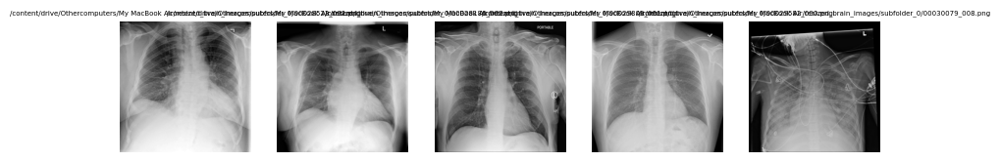

In [11]:
num_img_to_display = 5
imgs_to_display = image_files[:num_img_to_display]

plt.figure(figsize=(10,10))
for i, img_file in enumerate(imgs_to_display):
  img_path = os.path.join(output_dir, img_file)
  img = Image.open(img_path)

  plt.subplot(1, num_img_to_display, i+1)
  plt.imshow(img, cmap='gray')
  print(img_file)
  plt.title(img_file, fontsize=5)
  plt.axis('off')

plt.show()

In [13]:
# Load in the labels
labels_df = pd.read_csv("/content/Data_Entry_2017_v2020.csv")

In [14]:
labels_df['Finding Labels']

,Finding Labels
0,Cardiomegaly
1,Cardiomegaly|Emphysema
2,Cardiomegaly|Effusion
3,No Finding
4,Hernia
5,Hernia
6,Hernia|Infiltration
7,Hernia
8,Hernia
9,Hernia


In [15]:
# df with full paths
full_paths_df = pd.DataFrame(image_files, columns=['Full Path'])

# Get image names as key for merging
full_paths_df['Image Index'] = full_paths_df['Full Path'].apply(lambda x: os.path.basename(x))

In [16]:
# Add full file paths to labels df
merged_labels_df = pd.merge(labels_df, full_paths_df, on='Image Index', how='left')

In [17]:
# Split into train-val-test by patient ID (so no overlapping patients)
unique_patients = merged_labels_df['Patient ID'].unique()
train_patients, temp_patients = train_test_split(unique_patients, test_size=0.0669, random_state=42)
val_patients, test_patients = train_test_split(temp_patients, test_size=0.1887, random_state=42)

train_patients.shape, val_patients.shape, test_patients.shape

((28744,), (1672,), (389,))

In [18]:
# Get the image indices corresponding to the patients
train_df = merged_labels_df[merged_labels_df['Patient ID'].isin(train_patients)].copy()
val_df = merged_labels_df[merged_labels_df['Patient ID'].isin(val_patients)].copy()
test_df = merged_labels_df[merged_labels_df['Patient ID'].isin(test_patients)].copy()

train_df['Image Index']

,Image Index
0,00000001_000.png
1,00000001_001.png
2,00000001_002.png
3,00000002_000.png
4,00000003_001.png
5,00000003_002.png
6,00000003_003.png
7,00000003_004.png
8,00000003_005.png
9,00000003_006.png


In [19]:
test_df['Finding Labels']

,Finding Labels
813,No Finding
814,No Finding
815,No Finding
816,No Finding
1089,No Finding
1509,No Finding
1510,Effusion
1511,Infiltration|Pneumonia
1512,Cardiomegaly|Fibrosis
1513,No Finding


In [20]:
# Reset the index of the DataFrame
train_df = train_df.reset_index(drop=True)
val_df = val_df.reset_index(drop=True)
test_df = test_df.reset_index(drop=True)

In [21]:
# Create new pnemonia column
train_df.loc[:, 'Pneumonia'] = train_df['Finding Labels'].apply(lambda x: 1 if 'Pneumonia' in x else 0)

val_df.loc[:, 'Pneumonia'] = val_df['Finding Labels'].apply(lambda x: 1 if 'Pneumonia' in x else 0)

test_df.loc[:, 'Pneumonia'] = test_df['Finding Labels'].apply(lambda x: 1 if 'Pneumonia' in x else 0)

In [22]:
# Get images corresponding to image indices
X_train_imgs = train_df['Full Path'].tolist()
y_train = train_df['Pneumonia']

X_val_imgs = val_df['Full Path'].tolist()
y_val = val_df['Pneumonia']

X_test_imgs = test_df['Full Path'].tolist()
y_test = test_df['Pneumonia']

In [23]:
X_train_imgs[:5]

['/content/drive/Othercomputers/My MacBook Air/resized_brain_images/subfolder_109/00000001_000.png',
 '/content/drive/Othercomputers/My MacBook Air/resized_brain_images/subfolder_108/00000001_001.png',
 '/content/drive/Othercomputers/My MacBook Air/resized_brain_images/subfolder_112/00000001_002.png',
 '/content/drive/Othercomputers/My MacBook Air/resized_brain_images/subfolder_107/00000002_000.png',
 '/content/drive/Othercomputers/My MacBook Air/resized_brain_images/subfolder_109/00000003_001.png']

In [24]:
from concurrent.futures import ThreadPoolExecutor
# Convert images to np arrays - batch processing to not overload memory

def preprocess_image(img_path):
    img = Image.open(img_path).convert('L')
    return np.array(img)

def preprocess_in_batches(img_files, batch_size=100):
    with ThreadPoolExecutor(max_workers=4) as executor:
        for i in range(0, len(img_files), batch_size):
            batch_files = img_files[i:i+batch_size]
            batch_images = list(executor.map(preprocess_image, batch_files))
            yield np.array(batch_images)

In [25]:
def compute_stats(img_files):
    train_n_images = 0
    train_mean_sum = 0.0
    train_std_sum = 0.0

    # First pass to calculate mean
    for batch_images in preprocess_in_batches(img_files):
        train_n_images += batch_images.shape[0]
        train_mean_sum += np.sum(batch_images)
        if train_n_images % 1000 == 0: print(train_n_images)

    train_mean = train_mean_sum / (train_n_images * 224 * 224)

    # Second pass to calculate std
    for batch_images in preprocess_in_batches(img_files):
        train_std_sum += np.sum((batch_images - train_mean) ** 2)

    train_std = np.sqrt(train_std_sum / (train_n_images * 224 * 224))
    return train_mean, train_std

# train_mean, train_std = compute_stats(X_train_imgs)

In [26]:
# (127.04226838534306, 63.36335963450156)
train_mean = 127.04226838534306
train_std = 63.36335963450156

In [27]:
# Normalize images
def normalize_images(img_files, mean, std):
    normalized_images = []
    for batch_images in preprocess_in_batches(img_files):
        normalized_batch = (batch_images - mean) / std
        normalized_images.append(normalized_batch)
    return np.concatenate(normalized_images, axis=0)


In [28]:
# normalized_train_imgs = normalize_images(X_train_imgs, train_mean, train_std)

In [29]:
# # Also do batch normalization for val and test sets
# X_val_img_paths = [os.path.join(output_dir, img_file) for img_file in X_val_imgs]

# val_n_images = 0
# val_mean_sum = 0
# val_std_sum = 0

# for images_batch in preprocess_in_batches(X_val_img_paths):
#     n_batch += images_batch.shape[0]
#     val_mean_sum += np.sum(images_batch)
#     val_n_images += n_batch

# X_val_mean = val_mean_sum / (val_n_images * 224 * 224)

# for images_batch in preprocess_in_batches(X_val_img_paths):
#     val_std_sum += np.sum((images_batch - X_val_mean) ** 2)

# X_val_std = np.sqrt(val_std_sum / (val_n_images * 224 * 224))

# # Normalize by subtracting mean and dividing by std

# val_imgs_norm = []
# for images_batch in preprocess_in_batches(X_val_img_paths):
#     images_norm = (images_batch - X_val_mean) - X_val_std

# normalized_val_imgs = np.concatenate(val_imgs_norm, axis = 0)

In [30]:
# # Batch normalization for test set
# X_test_img_paths = [os.path.join(output_dir, img_file) for img_file in X_test_imgs]

# test_n_images = 0
# test_mean_sum = 0
# test_std_sum = 0

# for images_batch in preprocess_in_batches(X_test_img_paths):
#     num_images = images_batch.shape[0]
#     test_mean_sum += images_batch
#     test_n_images += num_images

# X_test_mean = test_mean_sum / (test_n_images * 224 * 224)

# for images_batch in preprocess_in_batches(X_test_img_paths):
#     test_std_sum += np.sum((images_batch - X_test_mean) ** 2)

# X_test_std = np.sqrt(test_std_sum / (test_n_images * 224 * 224))

# test_imgs_norm = []
# for images_batch in preprocess_in_batches(X_test_img_paths):
#     norm_images_batch = (images_batch - X_test_mean) / X_test_std
#     test_imgs_norm.append(images_batch)

# normalized_test_imgs = np.concatenate(test_imgs_norm, axis = 0)

Now we are going to augment the data using horizontal flipping. To do this we use OpenCV because it is highly optimized for processing tasks and operates directly on arrays.

In [31]:
# # Augment data using random horizontal flipping
# def flip_image(image_path):
#   img = cv2.imread(image_path)

#   # Randomly decide if we will flip the image or not
#   if np.random.rand() > 0.5:
#     img = cv2.flip(img, 1) # The 1 is for flipping horizontally
#   return img

# def flip_images_in_batches(image_paths, batch_size=100):
#   for i in range(len(image_paths), batch_size):
#     # Get each batch of images
#     batch_paths = image_paths[i:i+batch_size]

#     # Use ThreadPoolExecutor to speed up code with parallel processing
#     with ThreadPoolExecutor(max_workers=os.cpu_count()) as executor:
#       batch_results = list(executor.map(flip_image, batch_paths))
#     yield batch_results

In [32]:
# Define a dataset class that contains images, labels and has function for retrieving an image and applying transforms
class MyDataset(torch.utils.data.Dataset):
  def __init__(self, img_paths, labels, transform=None):
    self.img_paths = img_paths
    self.labels = labels
    self.transform = transform

  def __len__(self):
    return len(self.img_paths)

  def __getitem__(self, index):
    try:
      img_path = self.img_paths[index]
      label = self.labels[index]
      image = Image.open(img_path).convert('RGB')
      if self.transform:
          image = self.transform(image)
    except Exception as e:
      print(f"Error with index {index}: {e}")
      print(f"Image path: {img_path}, Label: {label}")
      raise
    return image, torch.tensor([label], dtype=torch.float32)

In [33]:
# Define image transformations like converting to tensor, normalizing, augmenting
data_transforms = {
    'train': v2.Compose([
      v2.ToImage(),
      v2.ToDtype(torch.float32, scale=True),
      v2.Normalize(mean=[train_mean], std=[train_std]),
      v2.RandomHorizontalFlip()
    ]),
    'val': v2.Compose([
        v2.ToImage(),
        v2.ToDtype(torch.float32, scale=True),
        v2.Normalize(mean=[train_mean], std=[train_std])
    ]),
    'test': v2.Compose([
        v2.ToImage(),
        v2.ToDtype(torch.float32, scale=True),
        v2.Normalize(mean=[train_mean], std=[train_std])
    ])
}

In [34]:
# Create an instance of dataset and dataloader
train_dataset = MyDataset(X_train_imgs, y_train, transform=data_transforms['train'])
val_dataset = MyDataset(X_val_imgs, y_val, transform=data_transforms['val'])

# Create dataloader for batching, shuffling, and loading data in parallel using worker threads
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, num_workers=4)
val_loader = DataLoader(val_dataset, batch_size=16, num_workers=4)

In [35]:
# Validate dataset consistency
def validate_dataset(dataset):
    assert len(dataset.img_paths) == len(dataset.labels), "Mismatch in lengths of image paths and labels."
    for i in range(len(dataset)):
        if i >= len(dataset.labels) or i >= len(dataset.img_paths):
            print(f"Index {i} is out of range for labels or image paths.")
            continue
        try:
            _, _ = dataset[i]
        except KeyError as e:
            print(f"KeyError for index {i}: {e}")
        except Exception as e:
            print(f"Exception at index {i}: {e}")

# Run validation
# validate_dataset(train_dataset)
validate_dataset(val_dataset)

KeyboardInterrupt: 

Model is trained using the Adam optimizer with standard parameters (0.9 and 0.999) and an initial learning rate of 0.001 that is decayed by a factor of 10 every time the validation loss plateaus.

Scheduler: this decays the learning rate
* patience=1: scheduler waits for 1 epoch beyond plateau before applying the decay
* 'min': specifies that we want the validation loss to be minimized

Now we are going to train the model. Here are a few important notes about training:
* for each epoch there are 2 phases: training and validation
* during model evaluation, Pytorch deactivates dropout and batch normalization
* we keep track of the best model and save the model weights with the lowest validation loss
* stepping the scheduler adjusts the learning rate

In [36]:
import copy
import time
from tqdm import tqdm

In [37]:
print("Training set size:", len(train_loader.dataset))
print("Validation set size:", len(val_loader.dataset))

Training set size: 104928
Validation set size: 5853


In [38]:
def save_checkpoint(model, optimizer, epoch, loss, filename='checkpoint.pth.tar'):
    state = {
        'epoch': epoch,
        'state_dict': model.state_dict(),
        'optimizer': optimizer.state_dict(),
        'loss': loss,
    }
    torch.save(state, filename)

In [39]:
def load_checkpoint(filename='checkpoint.pth.tar'):
    if os.path.isfile(filename):
        checkpoint = torch.load(filename)
        model = initialize_model().to('cuda')
        optimizer = optim.Adam(model.parameters(), lr=0.001)
        model.load_state_dict(checkpoint['state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer'])
        epoch = checkpoint['epoch']
        loss = checkpoint['loss']
        return model, optimizer, epoch, loss
    else:
        print("=> no checkpoint found at '{}'".format(filename))
        return None, None, None, None

In [40]:
# Convert labels to Float and ensure correct shape
def train_model_with_checkpoints(model, criterion, optimizer, scheduler, train_loader, val_loader, start_epoch=0, num_epochs=25, checkpoint_interval=1):

  best_model_wts = copy.deepcopy(model.state_dict())
  best_loss = float('inf') # Unbounded upper val for comparision
  epoch_times = []

  for epoch in range(num_epochs):
    print(f'Epoch: {epoch+1}/{num_epochs}')
    print("-" * 10)

    epoch_start = time.time()

    # Each epoch has a train and val phase
    for phase in ['train', 'val']:
      if phase == 'train':
        model.train()
      else:
        model.eval()

      running_loss = 0.0

      data_loader = train_loader if phase == 'train' else val_loader

      # Initialize tqdm progress bar
      progress_bar = tqdm(data_loader, desc=f"{phase} Epoch {epoch+1}/{num_epochs}")

      for inputs, labels in progress_bar:
        inputs, labels = inputs.to('cuda'), labels.to('cuda').float().view(-1, 1)  # Convert labels to Float and reshape

        # Zero the parameter gradients
        optimizer.zero_grad()

        # Forward pass - only track history if in train
        with torch.set_grad_enabled(phase == 'train'):
          outputs = model(inputs)

          try:
            loss = criterion(outputs, labels)
          except Exception as e:
            print(f"Error computing loss: {e}")
            print(f"Outputs: {outputs}")
            print(f"Labels: {labels}")
            raise

          # Loss backwardss (only for train phase)
          if phase == 'train':
            loss.backward()
            optimizer.step()

        running_loss += loss.item() * inputs.size(0)

        # Update the progress bar
        progress_bar.set_postfix(loss=running_loss / ((progress_bar.n + 1) * data_loader.batch_size))


      epoch_loss = running_loss / len(data_loader.dataset)

      print(f'{phase}, Loss: {epoch_loss:.4f}')

      # Deep copy the model
      if phase == 'val' and epoch_loss < best_loss:
        best_loss = epoch_loss
        best_model_wts = copy.deepcopy(model.state_dict())
        print(f'New best model found at epoch {epoch+1}')

      if phase == 'val':
        # Step the scheduler
        scheduler.step(epoch_loss)

    # Save checkpoint
    if epoch % checkpoint_interval == 0 or epoch == num_epochs - 1:
        torch.save(model.state_dict(), f'model_checkpoint_epoch_{epoch+1}.pth')
        print(f'Checkpoint saved at epoch {epoch+1}')

    epoch_end = time.time()
    epoch_duration = epoch_end - epoch_start
    epoch_times.append(epoch_duration)

    print(f'Epoch duration: {epoch_duration:.2f} seconds')


  avg_epoch_time = sum(epoch_times) / len(epoch_times)
  print(f'Average epoch time: {avg_epoch_time:.2f} seconds')

  total_estimated_time = avg_epoch_time * num_epochs
  print(f'Estimated total training time for {num_epochs} epochs: {total_estimated_time/60:.2f} minutes')

  print('Best val loss: {:4f}'.format(best_loss))
  # Load best model weights
  model.load_state_dict(best_model_wts)

  print('Finished Training')
  return model


In [41]:
# Initialize weights using DenseNet pretrained on ImageNet, turn it into binary classification
def initialize_model(num_classes=1):
  # Load pretrained DenseNet121
  model = models.densenet121(pretrained=True)
  # Replace the classifier
  num_ftrs = model.classifier.in_features # num features coming into last layer
  model.classifier = nn.Sequential(
      nn.Linear(num_ftrs, 1),
      nn.Sigmoid()
  )
  return model

In [42]:
# Calculate class weights
num_pos = sum(y_train)
num_neg = sum(y_train) - num_pos
w_pos = num_neg / (num_pos + num_neg)
w_neg = num_pos / (num_pos + num_neg)

In [43]:
# Define loss function with class weights
class_weight = torch.tensor([w_neg, w_pos], dtype=torch.float32).to('cuda')

In [44]:
# Load from checkpoint if available
model, optimizer, start_epoch, _ = load_checkpoint()

# If no checkpoint found, initialize from scratch
if model is None:
    model = initialize_model().to('cuda')
    optimizer = optim.Adam(model.parameters(), lr=0.001, betas=(0.9, 0.999))
    start_epoch = 0


=> no checkpoint found at 'checkpoint.pth.tar'


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/densenet121-a639ec97.pth" to /root/.cache/torch/hub/checkpoints/densenet121-a639ec97.pth
100%|██████████| 30.8M/30.8M [00:00<00:00, 167MB/s]


In [45]:
# Configure optimizer, loss fn, and scheduler
optimizer = optim.Adam(model.parameters(), lr=0.001, betas=(0.9, 0.999))
criterion = nn.BCEWithLogitsLoss(pos_weight=torch.tensor(1.0).to('cuda'))

# Decays lr by factor of 10 when validatin loss (min) plateaus
scheduler = ReduceLROnPlateau(optimizer, 'min', factor=0.1, patience=1)

In [ ]:
# Train the model with checkpoints
trained_model = train_model_with_checkpoints(model, criterion, optimizer, scheduler, train_loader, val_loader, start_epoch=start_epoch, num_epochs=1)

Epoch: 1/1
----------


train Epoch 1/1:   2%|▏         | 124/6558 [05:44<3:20:57,  1.87s/it, loss=0.703]

In [ ]:
# Save the model state
torch.save({
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'loss': 0.07,
}, f'checkpoint_epoch_{1}.pth.tar')



In [ ]:
# Load the saved model state
checkpoint = torch.load('checkpoint_epoch_1.pth.tar')
model.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
best_loss = checkpoint['loss']

model.eval()  # Set the model to evaluation mode

print(f'Model loaded from epoch 1 with loss {best_loss:.4f}')

Model loaded from epoch 1 with loss 0.0700


Testing the model

In [ ]:
from sklearn.metrics import f1_score, classification_report, confusion_matrix
import seaborn as sns


In [ ]:
def evaluate_model(model, test_loader, criterion):
    model.eval()
    test_loss = 0.0
    correct = 0
    total = 0
    y_true = []
    y_pred = []

    with torch.no_grad():
        for inputs, labels in tqdm(test_loader, desc='Testing'):
            inputs, labels = inputs.to('cuda'), labels.to('cuda')
            labels = labels.view(-1, 1)
            outputs = model(inputs)
            loss = criterion(outputs, labels.float())
            test_loss += loss.item() * inputs.size(0)
            preds = (outputs > 0.5).float()
            y_true.extend(labels.cpu().numpy())
            y_pred.extend(preds.cpu().numpy())
            correct += (preds == labels).sum().item()
            total += labels.size(0)

    test_loss /= total
    accuracy = correct / total

    y_true = np.array(y_true).flatten()
    y_pred = np.array(y_pred).flatten()

    f1 = f1_score(y_true, y_pred)
    print(f'Test Loss: {test_loss:.4f}')
    print(f'Test Accuracy: {accuracy:.4f}')
    print(f'F1 Score: {f1:.4f}')

    # Confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    plt.figure(figsize=(10, 7))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

In [ ]:
test_dataset = MyDataset(X_test_imgs, y_test, transform=data_transforms['test'])
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=False)

Testing: 100%|██████████| 84/84 [00:10<00:00,  8.07it/s]


Test Loss: 0.0639
Test Accuracy: 0.9888
F1 Score: 0.0000


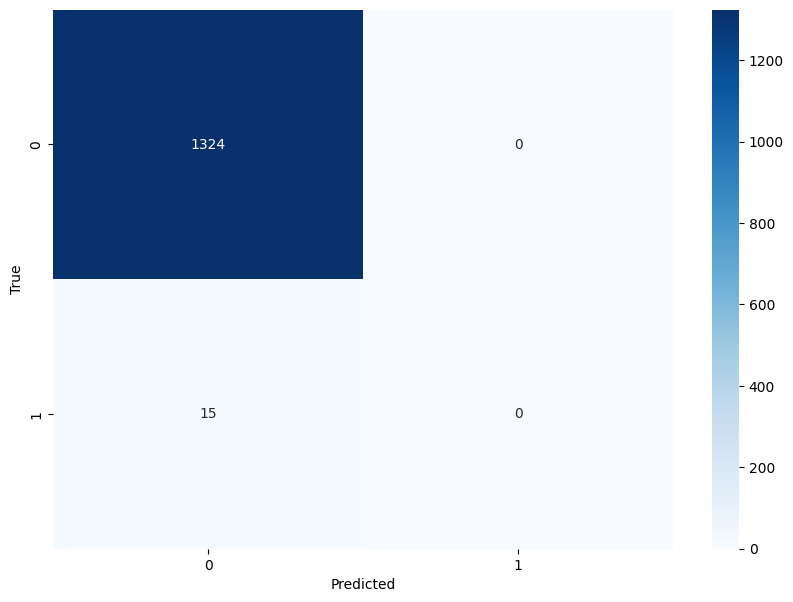

In [ ]:
# Evaluate the model on the test set
evaluate_model(model, test_loader, criterion)

In [ ]:
print("Training set size:", len(train_loader.dataset))
print("Validation set size:", len(val_loader.dataset))
print("Test set size:", len(test_loader.dataset))

Training set size: 104928
Validation set size: 5853
Test set size: 1339
